# Importing Necessary Libraries

In [ ]:
!pip install raceplotly spotipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import numpy as np
import pandas as pd

from raceplotly.plots import barplot
import missingno
import seaborn as sns
import plotly.express as px 
import plotly.graph_objects as go
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import spotipy as sp

import warnings
warnings.filterwarnings("ignore")

# Importing Dataset

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data.csv')
df_year = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data_by_year.csv')
df_genre = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Data Mining/Spotify Recommendation System/data/data_by_genres.csv')

In [ ]:
df_genre


,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7


#Exploratory Data Analysis

## Searching for Missing Values

Text(0.5, 1.0, 'Missing records in dataset')

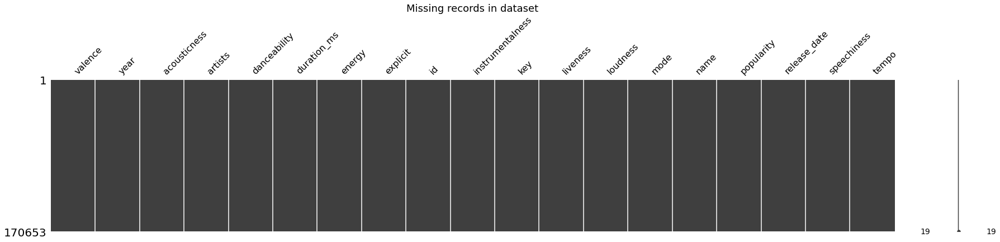

In [ ]:
missingno.matrix(df, figsize = (30,5))
plt.title("Missing records in dataset", fontsize = '18')

Text(0.5, 1.0, 'Missing records in dataset')

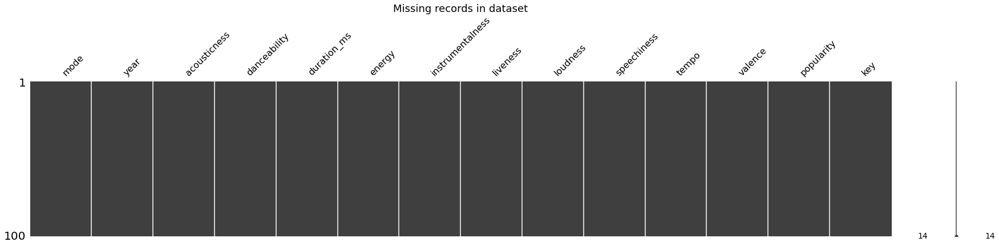

In [ ]:
missingno.matrix(df_year, figsize = (30,5))
plt.title("Missing records in dataset", fontsize = '18')

Text(0.5, 1.0, 'Missing records in dataset')

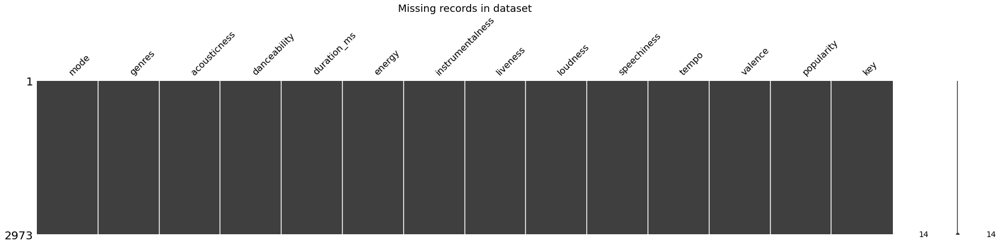

In [ ]:
missingno.matrix(df_genre, figsize = (30,5))
plt.title("Missing records in dataset", fontsize = '18')

## Basic Analysis

In [ ]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [ ]:
year_count = df['year'].value_counts(ascending = False).reset_index()
year_count.rename(columns = {'index':'year', 'year':'count'}, inplace = True) 
year_count['year'] = year_count.year.astype('int32')
year_count.sort_values(by=['year'], inplace = True)
year_count['year'] = pd.to_datetime(year_count.year, format='%Y')
year_count = year_count.set_index('year')
year_count = year_count.resample('10AS').sum()
year_count =  year_count.reset_index()


In [ ]:
fig = px.bar(year_count, x="year", y='count', title="NO. OF SONGS IN THE DATASET BY YEARS")
fig.show(renderer="colab") 

In [ ]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(df_year, x='year', y=sound_features, title="MUSIC PROFILE THROUGHOUT THE YEARS")
fig.add_vrect(x0=1966, x1=1966, line_width=1, line_color="red")

fig.show(renderer="colab")

In [ ]:
top10_genres = df_genre.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title = 'TOP 10 GENRES AND THEIR MUSIC PROFILE COMPOSITION')
fig.show(renderer="colab")

In [ ]:
df_corr = round(df.corr(),2)
fig = px.imshow(df_corr, text_auto=True, title='CORRELATION HEATMAP')
fig.update_layout(
    autosize=False,
    width=1000,
    height=1000)
fig.show(renderer="colab")

In [ ]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


## PCA to Analyze Songs

In [ ]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
text1 = df["artists"] + " - " + df["name"]
text2 = text1.values

X = df[chosen].values
y = df["danceability"].values

scaler = MinMaxScaler()
X = scaler.fit_transform(X)

pca = PCA(n_components=3)
pca.fit(X)

X = pca.transform(X)

In [ ]:
trace = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    text=text2,
    mode="markers",
    marker=dict(
        size=8,
        color=y,
        colorbar=dict(
            title="Danceability"
        )
    )
)

fig = go.Figure(data=[trace])

fig.update_layout(
    title='WHICH SONGS ARE DANCEABLE?', 
    autosize=False,
    width=1200, 
    height=900,
    margin=dict(l=65, r=50, b=65, t=90),
    scene=dict(
        xaxis_title="Principal Component 1",
        yaxis_title="Principal Component 2",
        zaxis_title="Principal Component 3",
    ),
)

fig.show(renderer="colab")


#Clustering Songs and applying PCA to get embeddings

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = df.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
df['cluster_label'] = song_cluster_labels

In [ ]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = df['name']
projection['cluster'] = df['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [ ]:
projection

,x,y,title,cluster
0,4.282671,2.295687,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",18
1,1.393692,-3.515458,Clancy Lowered the Boom,12
2,3.852978,1.734813,Gati Bali,18
3,2.538963,0.304617,Danny Boy,1
4,2.551298,-0.275335,When Irish Eyes Are Smiling,1
...,...,...,...,...
170648,-3.263860,0.573767,China,11
170649,-2.968660,0.168237,Halloweenie III: Seven Days,11
170650,-3.309008,0.673910,AYA,17
170651,-2.741518,-0.216859,Darkness,16


#Recommendation System

In [ ]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

#For authentication purpose
sp_call = sp.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
                                                           client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

In [ ]:
def find_song(name, year):
    song_data = defaultdict()
    results = sp_call.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp_call.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)
    


def unnest_dictionary(song_list_dict):
    
    flattened_dict = defaultdict()
    for key in song_list_dict[0].keys():
        flattened_dict[key] = []
    
    for dictionary in song_list_dict:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = unnest_dictionary(song_list)
    
    #Get mean vector of input song list
    song_center = get_mean_vector(song_list, spotify_data)

    #get scaler step from pipeline
    scaler = song_cluster_pipeline[0]

    #scale dataset vector
    scaled_data = scaler.transform(spotify_data[number_cols])

    #scale input vector
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))

    #calculate cosine similarity
    distances = cdist(scaled_song_center, scaled_data, 'cosine')

    #sort by similarity and select top n vectors
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    #fetch recommended songs based on index
    recommended_songs = spotify_data.iloc[index]
    recommended_songs = recommended_songs[~recommended_songs['name'].isin(song_dict['name'])]
    return recommended_songs[metadata_cols].to_dict(orient='records')

In [ ]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  df)

[{'name': 'Of Wolf And Man', 'year': 1991, 'artists': "['Metallica']"},
 {'name': 'Never Gonna Be Alone', 'year': 2008, 'artists': "['Nickelback']"},
 {'name': 'My Wish', 'year': 2006, 'artists': "['Rascal Flatts']"},
 {'name': 'Nuestro Amor',
  'year': 2005,
  'artists': "['RBD', 'Anahí', 'Dulce María', 'Maite Perroni', 'Christian Chávez', 'Christopher von Uckermann', 'Alfonso Herrera']"},
 {'name': 'Heads Carolina, Tails California',
  'year': 1996,
  'artists': "['Jo Dee Messina']"},
 {'name': 'Have A Nice Day', 'year': 2005, 'artists': "['Bon Jovi']"},
 {'name': 'Creature', 'year': 2015, 'artists': "['It Looks Sad.']"},
 {'name': 'Where Do Broken Hearts Go',
  'year': 2014,
  'artists': "['One Direction']"},
 {'name': 'DIFFERENT', 'year': 2018, 'artists': "['WOODZ']"},
 {'name': 'Hanging By A Moment', 'year': 2000, 'artists': "['Lifehouse']"}]

#END